# **STA 141B Final Project:** 

# **A Sentiment Analysis Investigation of RateMyProfessors.com Reviews for UC Davis Professors**
### Riley Adams, Jordan Bowman, Frankie Glaviano
### 7th December, 2022

This document is an agglomeration of all the code documents used to conduct our analysis. Originally, this work was done on a shared repository with several notebooks, all specialized to smaller tasks. For grading convenience, we have combined it all into one document. some lines of code which are no longer necessary as a result of combining the notebooks, are commented out.

**A note about running the document:** some tasks in this document, particularly the loop which performs the web-scraping to produce the *reviews* dataframe, are quite computationally intensive and will take a long time to run. For details on this, please see our report document.

# Data Collection: 

# Webscraping basic RateMyProfessors (RMP) info for all professors at UC Davis

In [1]:
# import modules
import pandas as pd
import numpy as np
import requests
#import requests_cache
import json
import time
import seaborn as sns
import matplotlib.pyplot as plt
import plotnine as p9
import re
import nltk
nltk.download('words')
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix, classification_report

[nltk_data] Downloading package words to C:\Users\Jordan
[nltk_data]     Bowman\AppData\Roaming\nltk_data...
[nltk_data]   Package words is already up-to-date!


In [2]:
# Set up cache
#requests_cache.install_cache("profs")

## Request data from RMP

In [3]:
# Endpoint and header for POST request
url = 'https://www.ratemyprofessors.com/graphql'
headers = {
    "Authorization": "Basic dGVzdDp0ZXN0", 
}

### Initial request (first 8 professors)

In [4]:
# Data provided for GraphQL
data = {
    "query":"query TeacherSearchPaginationQuery(\n  $count: Int!\n  $cursor: String\n  $query: TeacherSearchQuery!\n) {\n  search: newSearch {\n    ...TeacherSearchPagination_search_1jWD3d\n  }\n}\n\nfragment TeacherSearchPagination_search_1jWD3d on newSearch {\n  teachers(query: $query, first: $count, after: $cursor) {\n    didFallback\n    edges {\n      cursor\n      node {\n        ...TeacherCard_teacher\n        id\n        __typename\n      }\n    }\n    pageInfo {\n      hasNextPage\n      endCursor\n    }\n    resultCount\n    filters {\n      field\n      options {\n        value\n        id\n      }\n    }\n  }\n}\n\nfragment TeacherCard_teacher on Teacher {\n  id\n  legacyId\n  avgRating\n  numRatings\n  ...CardFeedback_teacher\n  ...CardSchool_teacher\n  ...CardName_teacher\n  ...TeacherBookmark_teacher\n}\n\nfragment CardFeedback_teacher on Teacher {\n  wouldTakeAgainPercent\n  avgDifficulty\n}\n\nfragment CardSchool_teacher on Teacher {\n  department\n  school {\n    name\n    id\n  }\n}\n\nfragment CardName_teacher on Teacher {\n  firstName\n  lastName\n}\n\nfragment TeacherBookmark_teacher on Teacher {\n  id\n  isSaved\n}\n",
    "variables":{
        "count":10000, # number of professors
        #"cursor":cursor,
        "query":{
            "text":"",
            "schoolID":"U2Nob29sLTEwNzM=",
            "fallback":True,
            "departmentID":None
        }
    }
} 

In [5]:
# Response/check status
response = requests.post(url, headers = headers, json=data)
response.raise_for_status()

In [6]:
# Put response into dataframe
cursorDF = pd.DataFrame(response.json()['data']['search']['teachers']['edges'])
cursorDF

,cursor,node
0,YXJyYXljb25uZWN0aW9uOjA=,"{'__typename': 'Teacher', 'avgDifficulty': 2.9..."
1,YXJyYXljb25uZWN0aW9uOjE=,"{'__typename': 'Teacher', 'avgDifficulty': 2.7..."
2,YXJyYXljb25uZWN0aW9uOjI=,"{'__typename': 'Teacher', 'avgDifficulty': 3.1..."
3,YXJyYXljb25uZWN0aW9uOjM=,"{'__typename': 'Teacher', 'avgDifficulty': 2.5..."
4,YXJyYXljb25uZWN0aW9uOjQ=,"{'__typename': 'Teacher', 'avgDifficulty': 3.6..."
...,...,...
4524,YXJyYXljb25uZWN0aW9uOjQ1MjQ=,"{'__typename': 'Teacher', 'avgDifficulty': 0, ..."
4525,YXJyYXljb25uZWN0aW9uOjQ1MjU=,"{'__typename': 'Teacher', 'avgDifficulty': 3.9..."
4526,YXJyYXljb25uZWN0aW9uOjQ1MjY=,"{'__typename': 'Teacher', 'avgDifficulty': 3.7..."
4527,YXJyYXljb25uZWN0aW9uOjQ1Mjc=,"{'__typename': 'Teacher', 'avgDifficulty': 3.4..."


In [7]:
# Initialize dataframe
profs = pd.DataFrame(columns=cursorDF['node'][0].keys())
profs

,__typename,avgDifficulty,avgRating,department,firstName,id,isSaved,lastName,legacyId,numRatings,school,wouldTakeAgainPercent


In [8]:
# loop to populate profs df
for i in range(0, len(cursorDF)):
    # Temporary dictionary
    tempDict = cursorDF['node'][i]
    # Delete problematic/unnecessary dictionary within dictionary
    del tempDict['school']
    # Convert dict to temporary dataframe
    tempDF = pd.DataFrame(tempDict, index=[i])
    # Append tempDF to profs df
    profs.loc[len(profs)] = tempDF.iloc[0,:]

In [9]:
# View profs df
profs

,__typename,avgDifficulty,avgRating,department,firstName,id,isSaved,lastName,legacyId,numRatings,school,wouldTakeAgainPercent
0,Teacher,2.9,3.3,Languages,Robert,VGVhY2hlci05NTY2,False,Borgen,9566,39,NaN,-1
1,Teacher,2.7,2.6,Anthropology,Aram,VGVhY2hlci05NTY4,False,Yengoyan,9568,47,NaN,-1
2,Teacher,3.1,3.2,Social Science,Patrick,VGVhY2hlci05NTcw,False,Carroll-Burke,9570,13,NaN,-1
3,Teacher,2.5,4.5,Anthropology,Henry,VGVhY2hlci0xMzQ4MQ==,False,McHenry,13481,124,NaN,-1
4,Teacher,3.6,3.8,Anthropology,Peter,VGVhY2hlci0yMjIzMA==,False,Rodman,22230,73,NaN,-1
...,...,...,...,...,...,...,...,...,...,...,...,...
4524,Teacher,0,0,Psychology,Joseph,VGVhY2hlci0yODU1OTkx,False,Armendarez,2855991,0,NaN,-1
4525,Teacher,3.9,2.3,Mathematics,Zhanerke,VGVhY2hlci0yNzUyNTU0,False,Temirgaliyeva,2752554,36,NaN,52.6316
4526,Teacher,3.7,2.6,Computer Science,Matt,VGVhY2hlci03ODA3Mw==,False,Farrens,78073,84,NaN,92.8571
4527,Teacher,3.4,2.1,Health Science,Lorena,VGVhY2hlci01ODY1MDY=,False,Garcia,586506,28,NaN,23.5294


In [10]:
# Tidy columns
profs = profs[['__typename', 'firstName', 'lastName', 'department', 'id', 'legacyId', 'numRatings', 'avgRating', 'avgDifficulty']]
profs

,__typename,firstName,lastName,department,id,legacyId,numRatings,avgRating,avgDifficulty
0,Teacher,Robert,Borgen,Languages,VGVhY2hlci05NTY2,9566,39,3.3,2.9
1,Teacher,Aram,Yengoyan,Anthropology,VGVhY2hlci05NTY4,9568,47,2.6,2.7
2,Teacher,Patrick,Carroll-Burke,Social Science,VGVhY2hlci05NTcw,9570,13,3.2,3.1
3,Teacher,Henry,McHenry,Anthropology,VGVhY2hlci0xMzQ4MQ==,13481,124,4.5,2.5
4,Teacher,Peter,Rodman,Anthropology,VGVhY2hlci0yMjIzMA==,22230,73,3.8,3.6
...,...,...,...,...,...,...,...,...,...
4524,Teacher,Joseph,Armendarez,Psychology,VGVhY2hlci0yODU1OTkx,2855991,0,0,0
4525,Teacher,Zhanerke,Temirgaliyeva,Mathematics,VGVhY2hlci0yNzUyNTU0,2752554,36,2.3,3.9
4526,Teacher,Matt,Farrens,Computer Science,VGVhY2hlci03ODA3Mw==,78073,84,2.6,3.7
4527,Teacher,Lorena,Garcia,Health Science,VGVhY2hlci01ODY1MDY=,586506,28,2.1,3.4


In [11]:
# Observe there are professors with 0 ratings.
profs[profs['avgRating'] < 1]

,__typename,firstName,lastName,department,id,legacyId,numRatings,avgRating,avgDifficulty
136,Teacher,Paul,Baumann,Biology,VGVhY2hlci0xNTkyODg=,159288,0,0,0
191,Teacher,Te,Williams,Agriculture,VGVhY2hlci0yMTQ2NzI=,214672,0,0,0
216,Teacher,Scott,Schonfeldt-Aultman,Ethnic Studies,VGVhY2hlci0yMjg4NDQ=,228844,0,0,0
229,Teacher,Craig,McDonald,Medicine,VGVhY2hlci0yNDczNDU=,247345,0,0,0
246,Teacher,Sharlene,Gilman,English,VGVhY2hlci0yNTg2ODc=,258687,0,0,0
...,...,...,...,...,...,...,...,...,...
4428,Teacher,Sen-Ching,Cheung,Computer Science,VGVhY2hlci0yODQxNDIw,2841420,0,0,0
4438,Teacher,Alessandro,Ossola,Environmental Science,VGVhY2hlci0yODQ0MDk3,2844097,0,0,0
4452,Teacher,Graham,McDougal,Art,VGVhY2hlci0yNjc2MzU4,2676358,0,0,0
4453,Teacher,Alexios,Panoutsopoulos,Biological Sciences,VGVhY2hlci0yODA1MzIz,2805323,0,0,0


In [12]:
# Drop rows with 0 ratings
idxRemove = profs[profs['avgRating'] < 1].index
profs = profs.drop(idxRemove)

In [ ]:
# Save profs df to csv
profs.to_csv("profs.csv")

# Data Collection:

# Web scraping all reviews for a single professor in profs dataframe

## Setup, imports

In [13]:
# set up cache
#requests_cache.install_cache("reviews")

## Request data from RMP

In [14]:
# Endpoint and header for POST request
url = 'https://www.ratemyprofessors.com/graphql'
headers = {
    "Authorization": "Basic dGVzdDp0ZXN0", 
}

### Experimenting: get reviews for first professor

In [15]:
data = {
    "query": "query RatingsListQuery(\n  $count: Int!\n  $id: ID!\n  $courseFilter: String\n  $cursor: String\n) {\n  node(id: $id) {\n    __typename\n    ... on Teacher {\n      ...RatingsList_teacher_4pguUW\n    }\n    id\n  }\n}\n\nfragment RatingsList_teacher_4pguUW on Teacher {\n  id\n  legacyId\n  lastName\n  numRatings\n  school {\n    id\n    legacyId\n    name\n    city\n    state\n    avgRating\n    numRatings\n  }\n  ...Rating_teacher\n  ...NoRatingsArea_teacher\n  ratings(first: $count, after: $cursor, courseFilter: $courseFilter) {\n    edges {\n      cursor\n      node {\n        ...Rating_rating\n        id\n        __typename\n      }\n    }\n    pageInfo {\n      hasNextPage\n      endCursor\n    }\n  }\n}\n\nfragment Rating_teacher on Teacher {\n  ...RatingFooter_teacher\n  ...RatingSuperHeader_teacher\n  ...ProfessorNoteSection_teacher\n}\n\nfragment NoRatingsArea_teacher on Teacher {\n  lastName\n  ...RateTeacherLink_teacher\n}\n\nfragment Rating_rating on Rating {\n  comment\n  flagStatus\n  createdByUser\n  teacherNote {\n    id\n  }\n  ...RatingHeader_rating\n  ...RatingSuperHeader_rating\n  ...RatingValues_rating\n  ...CourseMeta_rating\n  ...RatingTags_rating\n  ...RatingFooter_rating\n  ...ProfessorNoteSection_rating\n}\n\nfragment RatingHeader_rating on Rating {\n  date\n  class\n  helpfulRating\n  clarityRating\n  isForOnlineClass\n}\n\nfragment RatingSuperHeader_rating on Rating {\n  legacyId\n}\n\nfragment RatingValues_rating on Rating {\n  helpfulRating\n  clarityRating\n  difficultyRating\n}\n\nfragment CourseMeta_rating on Rating {\n  attendanceMandatory\n  wouldTakeAgain\n  grade\n  textbookUse\n  isForOnlineClass\n  isForCredit\n}\n\nfragment RatingTags_rating on Rating {\n  ratingTags\n}\n\nfragment RatingFooter_rating on Rating {\n  id\n  comment\n  adminReviewedAt\n  flagStatus\n  legacyId\n  thumbsUpTotal\n  thumbsDownTotal\n  thumbs {\n    userId\n    thumbsUp\n    thumbsDown\n    id\n  }\n  teacherNote {\n    id\n  }\n}\n\nfragment ProfessorNoteSection_rating on Rating {\n  teacherNote {\n    ...ProfessorNote_note\n    id\n  }\n  ...ProfessorNoteEditor_rating\n}\n\nfragment ProfessorNote_note on TeacherNotes {\n  comment\n  ...ProfessorNoteHeader_note\n  ...ProfessorNoteFooter_note\n}\n\nfragment ProfessorNoteEditor_rating on Rating {\n  id\n  legacyId\n  class\n  teacherNote {\n    id\n    teacherId\n    comment\n  }\n}\n\nfragment ProfessorNoteHeader_note on TeacherNotes {\n  createdAt\n  updatedAt\n}\n\nfragment ProfessorNoteFooter_note on TeacherNotes {\n  legacyId\n  flagStatus\n}\n\nfragment RateTeacherLink_teacher on Teacher {\n  legacyId\n  numRatings\n  lockStatus\n}\n\nfragment RatingFooter_teacher on Teacher {\n  id\n  legacyId\n  lockStatus\n  isProfCurrentUser\n}\n\nfragment RatingSuperHeader_teacher on Teacher {\n  firstName\n  lastName\n  legacyId\n  school {\n    name\n    id\n  }\n}\n\nfragment ProfessorNoteSection_teacher on Teacher {\n  ...ProfessorNote_teacher\n  ...ProfessorNoteEditor_teacher\n}\n\nfragment ProfessorNote_teacher on Teacher {\n  ...ProfessorNoteHeader_teacher\n  ...ProfessorNoteFooter_teacher\n}\n\nfragment ProfessorNoteEditor_teacher on Teacher {\n  id\n}\n\nfragment ProfessorNoteHeader_teacher on Teacher {\n  lastName\n}\n\nfragment ProfessorNoteFooter_teacher on Teacher {\n  legacyId\n  isProfCurrentUser\n}\n",
    "variables":{
        "count": 50,
        "id": "VGVhY2hlci05NTY2",
        #"courseFilter": null,
        #"cursor": "YXJyYXljb25uZWN0aW9uOjE5"
    }
}

In [16]:
# Response/check status
response = requests.post(url, headers = headers, json=data)
response.raise_for_status()

In [17]:
# Convert professor info into a dict.
profInfoDict = {i:response.json()['data']['node'][i] for i in response.json()['data']['node'] if i in ['firstName', 'lastName', 'id', 'numRatings']}
profInfoDict

{'firstName': 'Robert',
 'id': 'VGVhY2hlci05NTY2',
 'lastName': 'Borgen',
 'numRatings': 39}

In [18]:
# Convert professor info from dict to df.
profInfo = pd.DataFrame(profInfoDict, index=[0])
profInfo

,firstName,id,lastName,numRatings
0,Robert,VGVhY2hlci05NTY2,Borgen,39


In [19]:
response.json()

{'data': {'node': {'__typename': 'Teacher',
   'firstName': 'Robert',
   'id': 'VGVhY2hlci05NTY2',
   'isProfCurrentUser': False,
   'lastName': 'Borgen',
   'legacyId': 9566,
   'lockStatus': 'none',
   'numRatings': 39,
   'ratings': {'edges': [{'cursor': 'YXJyYXljb25uZWN0aW9uOjA=',
      'node': {'__typename': 'Rating',
       'adminReviewedAt': '2011-01-26 17:30:48 +0000 UTC',
       'attendanceMandatory': '',
       'clarityRating': 5,
       'class': 'HIS194',
       'comment': 'He is amazing! I had lots of fun in his class. You just have to get used to it because it may seem a little bit odd.',
       'createdByUser': False,
       'date': '2011-01-26 17:21:05 +0000 UTC',
       'difficultyRating': 1,
       'flagStatus': 'UNFLAGGED',
       'grade': '',
       'helpfulRating': 5,
       'id': 'UmF0aW5nLTE4MTg0MzY4',
       'isForCredit': False,
       'isForOnlineClass': False,
       'legacyId': 18184368,
       'ratingTags': '',
       'teacherNote': None,
       'textbookUse

In [20]:
response.json()['data']['node']

{'__typename': 'Teacher',
 'firstName': 'Robert',
 'id': 'VGVhY2hlci05NTY2',
 'isProfCurrentUser': False,
 'lastName': 'Borgen',
 'legacyId': 9566,
 'lockStatus': 'none',
 'numRatings': 39,
 'ratings': {'edges': [{'cursor': 'YXJyYXljb25uZWN0aW9uOjA=',
    'node': {'__typename': 'Rating',
     'adminReviewedAt': '2011-01-26 17:30:48 +0000 UTC',
     'attendanceMandatory': '',
     'clarityRating': 5,
     'class': 'HIS194',
     'comment': 'He is amazing! I had lots of fun in his class. You just have to get used to it because it may seem a little bit odd.',
     'createdByUser': False,
     'date': '2011-01-26 17:21:05 +0000 UTC',
     'difficultyRating': 1,
     'flagStatus': 'UNFLAGGED',
     'grade': '',
     'helpfulRating': 5,
     'id': 'UmF0aW5nLTE4MTg0MzY4',
     'isForCredit': False,
     'isForOnlineClass': False,
     'legacyId': 18184368,
     'ratingTags': '',
     'teacherNote': None,
     'textbookUse': 5,
     'thumbs': [],
     'thumbsDownTotal': 0,
     'thumbsUpTotal'

In [21]:
response.json()['data']['node']['ratings']['edges']

[{'cursor': 'YXJyYXljb25uZWN0aW9uOjA=',
  'node': {'__typename': 'Rating',
   'adminReviewedAt': '2011-01-26 17:30:48 +0000 UTC',
   'attendanceMandatory': '',
   'clarityRating': 5,
   'class': 'HIS194',
   'comment': 'He is amazing! I had lots of fun in his class. You just have to get used to it because it may seem a little bit odd.',
   'createdByUser': False,
   'date': '2011-01-26 17:21:05 +0000 UTC',
   'difficultyRating': 1,
   'flagStatus': 'UNFLAGGED',
   'grade': '',
   'helpfulRating': 5,
   'id': 'UmF0aW5nLTE4MTg0MzY4',
   'isForCredit': False,
   'isForOnlineClass': False,
   'legacyId': 18184368,
   'ratingTags': '',
   'teacherNote': None,
   'textbookUse': 5,
   'thumbs': [],
   'thumbsDownTotal': 0,
   'thumbsUpTotal': 0,
   'wouldTakeAgain': None}},
 {'cursor': 'YXJyYXljb25uZWN0aW9uOjE=',
  'node': {'__typename': 'Rating',
   'adminReviewedAt': '2010-04-06 11:26:35 +0000 UTC',
   'attendanceMandatory': '',
   'clarityRating': 2,
   'class': 'HIS194A',
   'comment': 'B

In [22]:
# Put response info into a data frame
cursorDF = pd.DataFrame(response.json()['data']['node']['ratings']['edges'])

In [23]:
# Inspect first node.
cursorDF['node'][0]

{'__typename': 'Rating',
 'adminReviewedAt': '2011-01-26 17:30:48 +0000 UTC',
 'attendanceMandatory': '',
 'clarityRating': 5,
 'class': 'HIS194',
 'comment': 'He is amazing! I had lots of fun in his class. You just have to get used to it because it may seem a little bit odd.',
 'createdByUser': False,
 'date': '2011-01-26 17:21:05 +0000 UTC',
 'difficultyRating': 1,
 'flagStatus': 'UNFLAGGED',
 'grade': '',
 'helpfulRating': 5,
 'id': 'UmF0aW5nLTE4MTg0MzY4',
 'isForCredit': False,
 'isForOnlineClass': False,
 'legacyId': 18184368,
 'ratingTags': '',
 'teacherNote': None,
 'textbookUse': 5,
 'thumbs': [],
 'thumbsDownTotal': 0,
 'thumbsUpTotal': 0,
 'wouldTakeAgain': None}

In [24]:
# Initialize dataframe for reviews.
reviews = pd.DataFrame(columns=cursorDF['node'][0].keys())
reviews

,__typename,adminReviewedAt,attendanceMandatory,clarityRating,class,comment,createdByUser,date,difficultyRating,flagStatus,...,isForCredit,isForOnlineClass,legacyId,ratingTags,teacherNote,textbookUse,thumbs,thumbsDownTotal,thumbsUpTotal,wouldTakeAgain


In [25]:
# Loop to populate reviews df.
for i in range(0, len(cursorDF)):
    # Create temporary dictionary.
    tempDict = cursorDF['node'][i]
    # Convert dict to temporary dataframe.
    tempDF = pd.DataFrame([tempDict], index=[i])
    # Append tempDF to reviews df.
    reviews.loc[len(reviews)] = tempDF.iloc[0,:]

In [26]:
# View populated reviews df.
reviews

,__typename,adminReviewedAt,attendanceMandatory,clarityRating,class,comment,createdByUser,date,difficultyRating,flagStatus,...,isForCredit,isForOnlineClass,legacyId,ratingTags,teacherNote,textbookUse,thumbs,thumbsDownTotal,thumbsUpTotal,wouldTakeAgain
0,Rating,2011-01-26 17:30:48 +0000 UTC,,5,HIS194,He is amazing! I had lots of fun in his class....,False,2011-01-26 17:21:05 +0000 UTC,1,UNFLAGGED,...,False,False,18184368,,None,5,[],0,0,None
1,Rating,2010-04-06 11:26:35 +0000 UTC,,2,HIS194A,"Bad prof, simply put. Thankfully, Borgen is ap...",False,2010-01-11 21:59:48 +0000 UTC,2,UNFLAGGED,...,False,False,16712359,,None,5,[],0,0,None
2,Rating,2010-04-01 21:59:55 +0000 UTC,,2,HIS194A,"Pretentious, disorganized, rants, and goes off...",False,2009-12-22 00:52:25 +0000 UTC,2,UNFLAGGED,...,False,False,16620461,,None,5,[],1,0,None
3,Rating,2010-04-01 00:55:36 +0000 UTC,,2,HIS194A,"Very disorganized in lecture, does not go into...",False,2009-12-20 04:13:29 +0000 UTC,3,UNFLAGGED,...,False,False,16608094,,None,3,[],0,0,None
4,Rating,2010-03-09 21:34:28 +0000 UTC,,3,JPN101,"Pretentious, scatter-brained, and enjoys belit...",False,2009-11-12 23:29:20 +0000 UTC,2,UNFLAGGED,...,False,False,16361756,,None,4,[],0,0,None
5,Rating,2008-07-13 19:39:08 +0000 UTC,,4,HIS194A,"A little disorganized at times, but the man kn...",False,2008-04-10 22:42:52 +0000 UTC,4,UNFLAGGED,...,False,False,14274644,,None,5,[],0,0,None
6,Rating,2008-07-13 17:35:49 +0000 UTC,,3,HIS194A,The class would have been easy if I had more t...,False,2008-04-03 00:37:37 +0000 UTC,5,UNFLAGGED,...,False,False,14235767,,None,5,[],0,0,None
7,Rating,2008-07-13 16:47:52 +0000 UTC,,4,HIS194A,He obviously enjoys the material quite a lot a...,False,2008-03-30 04:08:51 +0000 UTC,4,UNFLAGGED,...,False,False,14216866,,None,5,[],0,0,None
8,Rating,2008-07-13 11:28:08 +0000 UTC,,3,HIS194A,He is a good guy but there is ridiculous amoun...,False,2008-03-20 06:56:18 +0000 UTC,5,UNFLAGGED,...,False,False,14183721,,None,5,[],0,0,None
9,Rating,None,,4,HIS9B,Take good notes during his lecture and you'll ...,False,2007-03-29 19:24:06 +0000 UTC,3,REVIEWED,...,False,False,11218257,,None,None,[],0,0,None


In [27]:
# View columns.
reviews.columns

Index(['__typename', 'adminReviewedAt', 'attendanceMandatory', 'clarityRating',
       'class', 'comment', 'createdByUser', 'date', 'difficultyRating',
       'flagStatus', 'grade', 'helpfulRating', 'id', 'isForCredit',
       'isForOnlineClass', 'legacyId', 'ratingTags', 'teacherNote',
       'textbookUse', 'thumbs', 'thumbsDownTotal', 'thumbsUpTotal',
       'wouldTakeAgain'],
      dtype='object')

In [28]:
# Tidy columns.
reviews = reviews.rename(columns={'id': 'reviewID'})

# Data Collection:

# Web scraping all reviews for all professors in profs dataframe

## Setup, imports

In [29]:
# set up cache
#requests_cache.install_cache("reviews")

In [30]:
# Read in profs data.
profs = pd.read_csv("profs.csv")
profs = profs.loc[:, profs.columns!='Unnamed: 0']
profs

,__typename,firstName,lastName,department,id,legacyId,numRatings,avgRating,avgDifficulty
0,Teacher,Robert,Borgen,Languages,VGVhY2hlci05NTY2,9566,39,3.3,2.9
1,Teacher,Aram,Yengoyan,Anthropology,VGVhY2hlci05NTY4,9568,47,2.6,2.7
2,Teacher,Patrick,Carroll-Burke,Social Science,VGVhY2hlci05NTcw,9570,13,3.2,3.1
3,Teacher,Henry,McHenry,Anthropology,VGVhY2hlci0xMzQ4MQ==,13481,124,4.5,2.5
4,Teacher,Peter,Rodman,Anthropology,VGVhY2hlci0yMjIzMA==,22230,73,3.8,3.6
...,...,...,...,...,...,...,...,...,...
3932,Teacher,Chris,Nitta,Computer Science,VGVhY2hlci00NjU5MTM=,465913,189,2.3,4.3
3933,Teacher,Daryl,Posnett,Computer Science,VGVhY2hlci0yNTA5NTcy,2509572,57,2.0,4.7
3934,Teacher,Daniel,Ferenc,Science,VGVhY2hlci0xMjUyNjg=,125268,29,1.6,3.7
3935,Teacher,Kenneth,Hilt,Biology,VGVhY2hlci0xNTE4OTQ=,151894,325,3.7,4.0


## Request data from RMP

In [31]:
# Endpoint and header for POST request
url = 'https://www.ratemyprofessors.com/graphql'
headers = {
    "Authorization": "Basic dGVzdDp0ZXN0", 
}

In [32]:
# Initialize dataframe.
reviews = pd.DataFrame(columns=['__typename', 'adminReviewedAt', 'attendanceMandatory', 'clarityRating',
       'class', 'comment', 'createdByUser', 'date', 'difficultyRating',
       'flagStatus', 'grade', 'helpfulRating', 'id', 'isForCredit',
       'isForOnlineClass', 'legacyId', 'ratingTags', 'teacherNote',
       'textbookUse', 'thumbs', 'thumbsDownTotal', 'thumbsUpTotal',
       'wouldTakeAgain'])
reviews

,__typename,adminReviewedAt,attendanceMandatory,clarityRating,class,comment,createdByUser,date,difficultyRating,flagStatus,...,isForCredit,isForOnlineClass,legacyId,ratingTags,teacherNote,textbookUse,thumbs,thumbsDownTotal,thumbsUpTotal,wouldTakeAgain


**STOP!** The code block below involves a lot of data retrieval. It will take potentially an hour or more to run. We advise jumping to the next section of the code on our EDA.

In [ ]:
# Initialize index
idx = 0
# Loop to get every review for every professor
for id in profs['id']:
    # Be polite with request speeed.
    time.sleep(0.05)
    
    # Query data for each professor.
    data = {
        "query": "query RatingsListQuery(\n  $count: Int!\n  $id: ID!\n  $courseFilter: String\n  $cursor: String\n) {\n  node(id: $id) {\n    __typename\n    ... on Teacher {\n      ...RatingsList_teacher_4pguUW\n    }\n    id\n  }\n}\n\nfragment RatingsList_teacher_4pguUW on Teacher {\n  id\n  legacyId\n  lastName\n  numRatings\n  school {\n    id\n    legacyId\n    name\n    city\n    state\n    avgRating\n    numRatings\n  }\n  ...Rating_teacher\n  ...NoRatingsArea_teacher\n  ratings(first: $count, after: $cursor, courseFilter: $courseFilter) {\n    edges {\n      cursor\n      node {\n        ...Rating_rating\n        id\n        __typename\n      }\n    }\n    pageInfo {\n      hasNextPage\n      endCursor\n    }\n  }\n}\n\nfragment Rating_teacher on Teacher {\n  ...RatingFooter_teacher\n  ...RatingSuperHeader_teacher\n  ...ProfessorNoteSection_teacher\n}\n\nfragment NoRatingsArea_teacher on Teacher {\n  lastName\n  ...RateTeacherLink_teacher\n}\n\nfragment Rating_rating on Rating {\n  comment\n  flagStatus\n  createdByUser\n  teacherNote {\n    id\n  }\n  ...RatingHeader_rating\n  ...RatingSuperHeader_rating\n  ...RatingValues_rating\n  ...CourseMeta_rating\n  ...RatingTags_rating\n  ...RatingFooter_rating\n  ...ProfessorNoteSection_rating\n}\n\nfragment RatingHeader_rating on Rating {\n  date\n  class\n  helpfulRating\n  clarityRating\n  isForOnlineClass\n}\n\nfragment RatingSuperHeader_rating on Rating {\n  legacyId\n}\n\nfragment RatingValues_rating on Rating {\n  helpfulRating\n  clarityRating\n  difficultyRating\n}\n\nfragment CourseMeta_rating on Rating {\n  attendanceMandatory\n  wouldTakeAgain\n  grade\n  textbookUse\n  isForOnlineClass\n  isForCredit\n}\n\nfragment RatingTags_rating on Rating {\n  ratingTags\n}\n\nfragment RatingFooter_rating on Rating {\n  id\n  comment\n  adminReviewedAt\n  flagStatus\n  legacyId\n  thumbsUpTotal\n  thumbsDownTotal\n  thumbs {\n    userId\n    thumbsUp\n    thumbsDown\n    id\n  }\n  teacherNote {\n    id\n  }\n}\n\nfragment ProfessorNoteSection_rating on Rating {\n  teacherNote {\n    ...ProfessorNote_note\n    id\n  }\n  ...ProfessorNoteEditor_rating\n}\n\nfragment ProfessorNote_note on TeacherNotes {\n  comment\n  ...ProfessorNoteHeader_note\n  ...ProfessorNoteFooter_note\n}\n\nfragment ProfessorNoteEditor_rating on Rating {\n  id\n  legacyId\n  class\n  teacherNote {\n    id\n    teacherId\n    comment\n  }\n}\n\nfragment ProfessorNoteHeader_note on TeacherNotes {\n  createdAt\n  updatedAt\n}\n\nfragment ProfessorNoteFooter_note on TeacherNotes {\n  legacyId\n  flagStatus\n}\n\nfragment RateTeacherLink_teacher on Teacher {\n  legacyId\n  numRatings\n  lockStatus\n}\n\nfragment RatingFooter_teacher on Teacher {\n  id\n  legacyId\n  lockStatus\n  isProfCurrentUser\n}\n\nfragment RatingSuperHeader_teacher on Teacher {\n  firstName\n  lastName\n  legacyId\n  school {\n    name\n    id\n  }\n}\n\nfragment ProfessorNoteSection_teacher on Teacher {\n  ...ProfessorNote_teacher\n  ...ProfessorNoteEditor_teacher\n}\n\nfragment ProfessorNote_teacher on Teacher {\n  ...ProfessorNoteHeader_teacher\n  ...ProfessorNoteFooter_teacher\n}\n\nfragment ProfessorNoteEditor_teacher on Teacher {\n  id\n}\n\nfragment ProfessorNoteHeader_teacher on Teacher {\n  lastName\n}\n\nfragment ProfessorNoteFooter_teacher on Teacher {\n  legacyId\n  isProfCurrentUser\n}\n",
        "variables":{
            "count": 900,
            "id": f"{id}"
            #"courseFilter": null,
            #"cursor": "YXJyYXljb25uZWN0aW9uOjE5"
        }
    }
    # Response.
    response = requests.post(url, headers = headers, json=data)

    # Make sure there are no errors in response.
    if 'errors' not in response.json():
        # Put response info into a data frame.
        cursorDF = pd.DataFrame(response.json()['data']['node']['ratings']['edges'])

        # Nested loop to extract data from cursorDF['node'] and append to reviews dataframe.
        for j in range(0, len(cursorDF)):
            # Temporary dictionary.
            tempDict = cursorDF['node'][j]
            # Convert dict to temporary dataframe.
            tempDF = pd.DataFrame([tempDict], index = [idx])
            # Increment index.
            idx += 1
            # Append tempDF to reviews df.
            reviews.loc[len(reviews)] = tempDF.iloc[0,:]

C:\Users\riley\AppData\Local\Temp\ipykernel_13124\1920870823.py:43: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  reviews.loc[len(reviews)] = tempDF.iloc[0,:]
C:\Users\riley\AppData\Local\Temp\ipykernel_13124\1920870823.py:43: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  reviews.loc[len(reviews)] = tempDF.iloc[0,:]
C:\Users\riley\AppData\Local\Temp\ipykernel_13124\1920870823.py:43: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  reviews.loc[len(reviews)] = tempDF.iloc[0,:]
C:\Users\riley\AppData\Local\Temp\ipykernel_13124\1920870823.py:43: FutureWarning: In a future version, object-dtype columns with all-bo

ReadTimeout: HTTPSConnectionPool(host='www.ratemyprofessors.com', port=443): Read timed out. (read timeout=None)

In [ ]:
# View the reviews dataframe.
reviews

,__typename,adminReviewedAt,attendanceMandatory,clarityRating,class,comment,createdByUser,date,difficultyRating,flagStatus,...,isForCredit,isForOnlineClass,legacyId,ratingTags,teacherNote,textbookUse,thumbs,thumbsDownTotal,thumbsUpTotal,wouldTakeAgain
0,Rating,2011-01-26 17:30:48 +0000 UTC,,5,HIS194,He is amazing! I had lots of fun in his class....,False,2011-01-26 17:21:05 +0000 UTC,1,UNFLAGGED,...,False,False,18184368,,None,5,[],0,0,None
1,Rating,2010-04-06 11:26:35 +0000 UTC,,2,HIS194A,"Bad prof, simply put. Thankfully, Borgen is ap...",False,2010-01-11 21:59:48 +0000 UTC,2,UNFLAGGED,...,False,False,16712359,,None,5,[],0,0,None
2,Rating,2010-04-01 21:59:55 +0000 UTC,,2,HIS194A,"Pretentious, disorganized, rants, and goes off...",False,2009-12-22 00:52:25 +0000 UTC,2,UNFLAGGED,...,False,False,16620461,,None,5,[],1,0,None
3,Rating,2010-04-01 00:55:36 +0000 UTC,,2,HIS194A,"Very disorganized in lecture, does not go into...",False,2009-12-20 04:13:29 +0000 UTC,3,UNFLAGGED,...,False,False,16608094,,None,3,[],0,0,None
4,Rating,2010-03-09 21:34:28 +0000 UTC,,3,JPN101,"Pretentious, scatter-brained, and enjoys belit...",False,2009-11-12 23:29:20 +0000 UTC,2,UNFLAGGED,...,False,False,16361756,,None,4,[],0,0,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65888,Rating,2019-12-22 18:18:42 +0000 UTC,mandatory,2,SOC128,Probably one of the worst classes I've taken h...,False,2019-12-22 18:13:45 +0000 UTC,4,UNFLAGGED,...,True,False,32744005,Get ready to read--Skip class? You won't pass....,None,0,[],0,0,0
65889,Rating,2019-12-08 23:10:05 +0000 UTC,mandatory,2,SOC128,Reading memos are time consuming and there is ...,False,2019-12-08 22:00:40 +0000 UTC,4,UNFLAGGED,...,True,False,32567988,Get ready to read--Tough grader,None,0,[],0,0,0
65890,Rating,2019-04-22 23:27:11 +0000 UTC,mandatory,4,SOC143,This class was great and the professor is real...,False,2019-04-22 19:53:30 +0000 UTC,4,UNFLAGGED,...,True,False,31644955,Get ready to read--Caring--Tough grader,None,0,[],1,0,1
65891,Rating,2019-04-22 23:10:29 +0000 UTC,mandatory,4,SOC143A,Professor Clerge gave us good readings and add...,False,2019-04-22 19:47:06 +0000 UTC,4,UNFLAGGED,...,True,False,31644880,Lots of homework--Skip class? You won't pass.-...,None,0,[],1,1,1


In [ ]:
# Save data to csv.
reviews.to_csv("reviews.csv") # comma separated

# Exploratory Data Analysis (EDA) and Data Cleaning for Professor Basic Info Data (profs)

## Setup

In [33]:
# Read in data
profs = pd.read_csv("profs.csv")
profs = profs.loc[:, profs.columns!='Unnamed: 0']
profs = profs.loc[:, profs.columns!='__typename']

## EDA

In [34]:
# View head and tail of data
profs

,firstName,lastName,department,id,legacyId,numRatings,avgRating,avgDifficulty
0,Robert,Borgen,Languages,VGVhY2hlci05NTY2,9566,39,3.3,2.9
1,Aram,Yengoyan,Anthropology,VGVhY2hlci05NTY4,9568,47,2.6,2.7
2,Patrick,Carroll-Burke,Social Science,VGVhY2hlci05NTcw,9570,13,3.2,3.1
3,Henry,McHenry,Anthropology,VGVhY2hlci0xMzQ4MQ==,13481,124,4.5,2.5
4,Peter,Rodman,Anthropology,VGVhY2hlci0yMjIzMA==,22230,73,3.8,3.6
...,...,...,...,...,...,...,...,...
3932,Chris,Nitta,Computer Science,VGVhY2hlci00NjU5MTM=,465913,189,2.3,4.3
3933,Daryl,Posnett,Computer Science,VGVhY2hlci0yNTA5NTcy,2509572,57,2.0,4.7
3934,Daniel,Ferenc,Science,VGVhY2hlci0xMjUyNjg=,125268,29,1.6,3.7
3935,Kenneth,Hilt,Biology,VGVhY2hlci0xNTE4OTQ=,151894,325,3.7,4.0


### Mean number of ratings for each professor

In [35]:
# Mean number of ratings
profs['numRatings'].mean()

21.41529083058166

### Distribution of number of ratings for each professor

Text(0, 0.5, 'Number of Ratings')

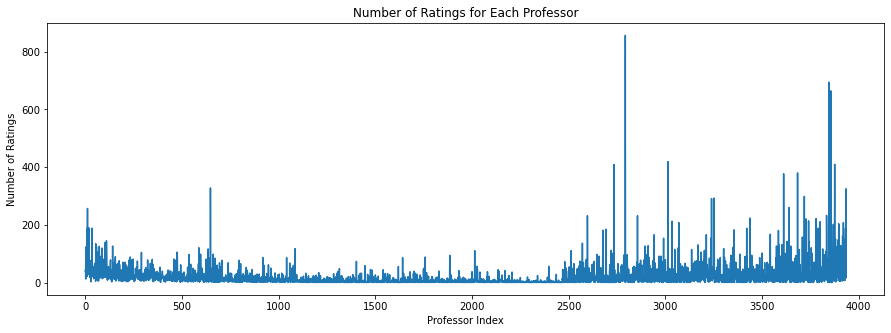

In [36]:
# Quick plot of ratings
plt.figure(figsize=(15,5))
profs['numRatings'].plot()
plt.title('Number of Ratings for Each Professor')
plt.xlabel('Professor Index')
plt.ylabel('Number of Ratings')


### Who has the most ratings?

In [37]:
# Prof with most ratings
profs.loc[profs['numRatings'].idxmax()]

firstName                     Andreas
lastName                   Toupadakis
department                  Chemistry
id               VGVhY2hlci01NjE1OTk=
legacyId                       561599
numRatings                        856
avgRating                         3.3
avgDifficulty                     3.1
Name: 2793, dtype: object

### Histograms of Quality Rating and Difficulty Rating

Text(0.5, 1.0, 'Histogram of Average Professor Quality Rating')

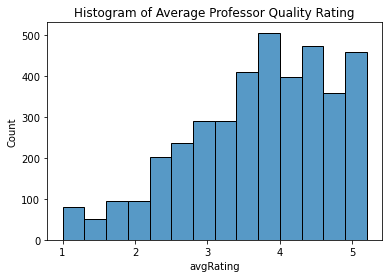

In [38]:
# Histogram of average rating
sns.histplot(profs['avgRating'], binwidth=0.3)
plt.title("Histogram of Average Professor Quality Rating")

Text(0.5, 1.0, 'Histogram of Average Professor Difficulty Rating')

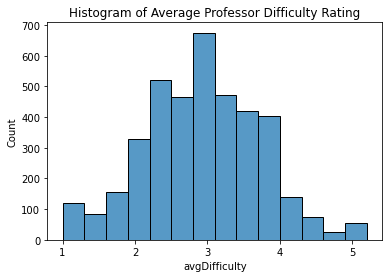

In [39]:
# Histogram of average difficulty rating
sns.histplot(profs['avgDifficulty'], binwidth=0.3)
plt.title("Histogram of Average Professor Difficulty Rating")

### Relationship between Average Difficulty Rating and Average Quality Rating

Text(0.5, 0, 'Mean Difficulty Rating')

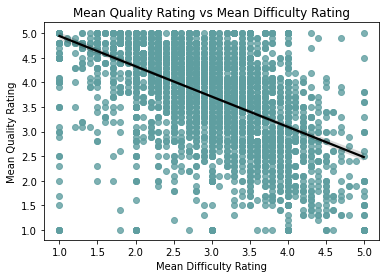

In [47]:
# Scatterplot rating vs difficulty
sns.regplot(x=profs['avgDifficulty'], y=profs['avgRating'],
            scatter_kws={"color": "cadetblue"},
            line_kws={"color": "black"})
plt.title("Mean Quality Rating vs Mean Difficulty Rating")
plt.ylabel("Mean Quality Rating")
plt.xlabel("Mean Difficulty Rating")

In [44]:
# Correlation
corr = profs['avgRating'].corr(profs['avgDifficulty'])
print("Correlation between average rating and average dificulty is: ", corr)

Correlation between average rating and average dificulty is:  -0.5135269815526113


### Quality Rankings, Difficulty Rankings, and Number of Reviews by Department

#### Quality

In [45]:
# Group by department, aggregate avgRating by mean, numRatings by sum
rating_by_dept = profs.groupby('department', as_index = False).agg({'avgRating': 'mean', 'numRatings': 'sum'})

# Round ratings
rating_by_dept['avgRating'] = rating_by_dept['avgRating'].round(decimals=2)

# Sort by rating (descending)
rating_by_dept = rating_by_dept.sort_values(by='avgRating', ascending=False)

# Reset index
rating_by_dept = rating_by_dept.reset_index(drop=True)

# View head, tail of dataframe
rating_by_dept

,department,avgRating,numRatings
0,Landscape Architecture amp Regional Planning,5.00,1
1,Landscape Architecture Regional Planning,5.00,2
2,Cell Biology & Neuroanatomy,5.00,13
3,Food Science amp Technology,5.00,3
4,Student Services,5.00,1
...,...,...,...
147,Agricultural & Resource Economics,2.96,218
148,Managerial Science,2.80,43
149,Business,2.78,29
150,Agricultural Engineering,2.75,15


Text(0.5, 0, 'Mean Quality Rating')

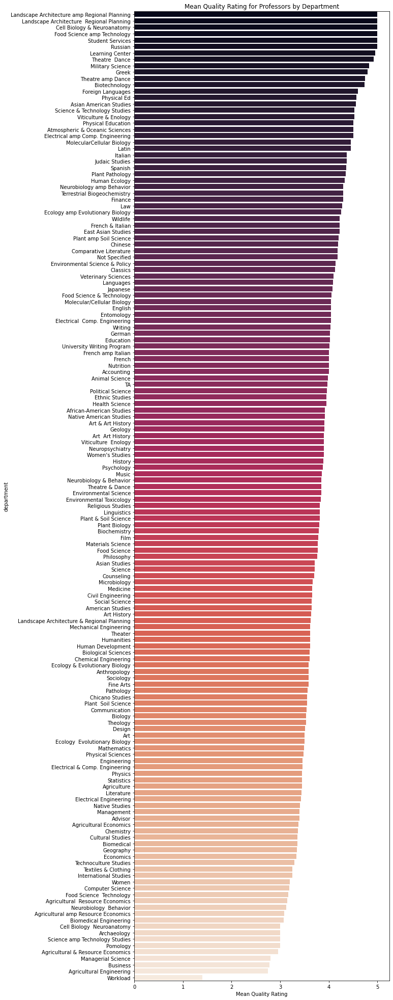

In [48]:
# Rating by dept barplot.
plt.figure(figsize=(9,35))
sns.barplot(y=rating_by_dept['department'], x=rating_by_dept['avgRating'],
            palette="rocket")
plt.title("Mean Quality Rating for Professors by Department")
plt.xlabel("Mean Quality Rating")

Notes: 

* We have some cleaning to do with regards to department names. For example, we have: Art & Art History, Art Art History, Art History and Art all listed as separate departments.

* The number one and two departments have very few ratings because they are typos of a dept much lower on the list. this should be dealt with to produce a more realistic ranking

* What is "Workload", "TA", "Advisor" ? Sounds like user error when inputting department names.

In [49]:
# Count number of unique departments
rating_by_dept['department'].nunique()

152

In [50]:
# Inspect "Workload" department
rating_by_dept.loc[rating_by_dept['department'] == 'Workload']

,department,avgRating,numRatings
151,Workload,1.4,23


Strange that is a lot of ratings to be an error.

In [51]:
# Inspect "TA" department
rating_by_dept.loc[rating_by_dept['department'] == 'TA']

,department,avgRating,numRatings
58,TA,3.97,65


65 ratings. Perhaps the user didn't know which department to put and the class was taught by a grad student TA? Or TA is an acronym?

In [52]:
# Inspect "Advisor" department
rating_by_dept.loc[rating_by_dept['department'] == 'Advisor']

,department,avgRating,numRatings
126,Advisor,3.4,22


I suspect that for TA and Advisor, users are rating TA's and Advisors as if they are their own departments. Will need to inspect the webpages to confirm.

#### Where does the statistics department lie in quality rankings?

In [53]:
# View statistics department ranking/average
statsRating = rating_by_dept.loc[rating_by_dept['department'] == 'Statistics']
statsRating = statsRating.reset_index()
print(f"The statistics department is ranked {statsRating.iloc[0]['index']} out of {len(rating_by_dept)} departments with a mean professor quality rating of {statsRating.iloc[0]['avgRating']} and a\
 total of {statsRating.iloc[0]['numRatings']} reviews given.")

The statistics department is ranked 120 out of 152 departments with a mean professor quality rating of 3.45 and a total of 2163 reviews given.


### Difficulty

In [54]:
# Group by department, aggregate avgDifficulty by mean, numRatings by sum
diff_by_dept = profs.groupby('department', as_index = False).agg({'avgDifficulty': 'mean', 'numRatings': 'sum'})

# Round difficulty ratings
diff_by_dept['avgDifficulty'] = diff_by_dept['avgDifficulty'].round(decimals=2)

# Sort by difficulty rating (descending)
diff_by_dept = diff_by_dept.sort_values(by='avgDifficulty', ascending=False)

# Reset index
diff_by_dept = diff_by_dept.reset_index(drop=True)

# View head, tail of dataframe
diff_by_dept

,department,avgDifficulty,numRatings
0,Workload,4.60,23
1,Cell Biology Neuroanatomy,4.25,4
2,Managerial Science,4.00,43
3,Pomology,4.00,1
4,Agricultural amp Resource Economics,3.90,28
...,...,...,...
147,Learning Center,1.90,95
148,Physical Ed,1.82,199
149,Military Science,1.67,4
150,Physical Education,1.59,62


Text(0.5, 0, 'Mean Difficulty Rating')

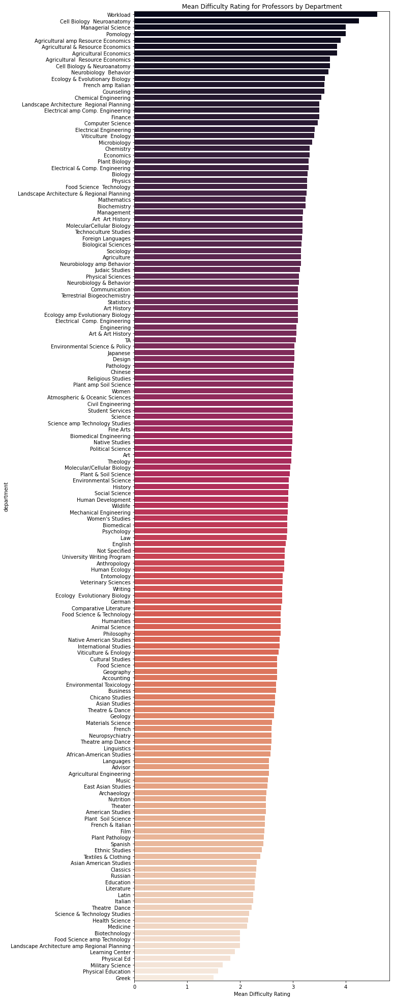

In [56]:
# Difficulty by dept barplot
plt.figure(figsize=(9,35))
sns.barplot( x=diff_by_dept['avgDifficulty'], y=diff_by_dept['department'],
            palette="rocket")
plt.title("Mean Difficulty Rating for Professors by Department")
plt.xlabel("Mean Difficulty Rating")

Notes:

* Same issues as quality plot above. need to combine repeats and investigate nonsense.

* Greek was very high in quality but is at the bottom of difficulty

#### Where does the statistics department lie in difficulty rankings?

In [57]:
# View statistics department ranking/average
statsDiff = diff_by_dept.loc[diff_by_dept['department'] == 'Statistics']
statsDiff = statsDiff.reset_index()
print(f"The statistics department is ranked {statsDiff.iloc[0]['index']} out of {len(diff_by_dept)} departments with a mean professor difficulty rating of {statsDiff.iloc[0]['avgDifficulty']} and a\
 total of {statsDiff.iloc[0]['numRatings']} reviews given.")

The statistics department is ranked 45 out of 152 departments with a mean professor difficulty rating of 3.1 and a total of 2163 reviews given.


#### Number of Ratings

In [58]:
# numRatings dataframe
num_by_dept = diff_by_dept[['department', 'numRatings']].sort_values(by='numRatings', ascending=False)
num_by_dept

,department,numRatings
29,Mathematics,9293
21,Chemistry,7715
83,English,4367
81,Psychology,4288
22,Economics,4052
...,...,...
14,Landscape Architecture Regional Planning,2
146,Landscape Architecture amp Regional Planning,1
64,Science amp Technology Studies,1
3,Pomology,1


Text(0.5, 0, 'Number of Ratings')

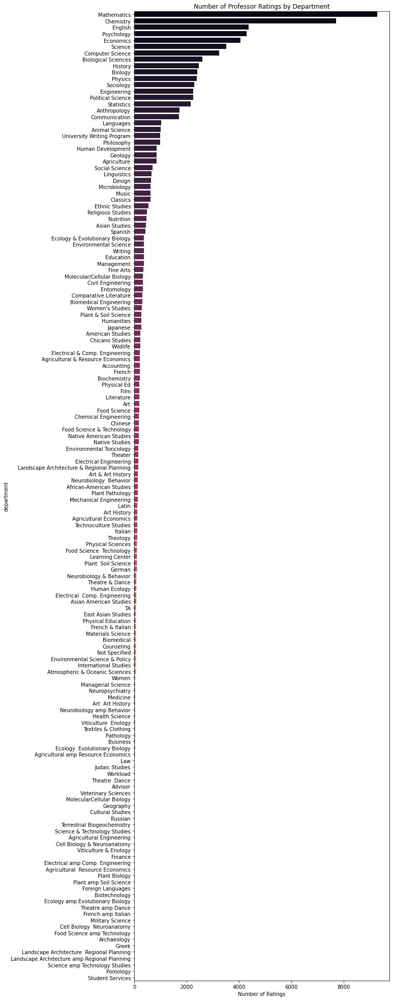

In [60]:
# Number of ratings by dept barplot
plt.figure(figsize=(9,35))
sns.barplot( x=num_by_dept['numRatings'], y=num_by_dept['department'],
            palette="rocket")
plt.title("Number of Professor Ratings by Department")
plt.xlabel("Number of Ratings")

Notes:

* many of the departments high in quality ranking are low in number of review ranking. e.g. Greek, Cell Biology Neuroanatomy

* math and chem have way more ratings than most!

* Science has a lot of reviews, but this is a vague term that doesn't describe an actual department

## Cleaning

Many of the repeated departments happen where there is the word 'and' or an ampersand '&'.

In [61]:
## Find all departments that contain an '&'
set(profs[profs['department'].str.contains('&')]['department'])

{'Agricultural & Resource Economics',
 'Art & Art History',
 'Atmospheric & Oceanic Sciences',
 'Cell Biology & Neuroanatomy',
 'Ecology & Evolutionary Biology',
 'Electrical & Comp. Engineering',
 'Environmental Science & Policy',
 'Food Science & Technology',
 'French & Italian',
 'Landscape Architecture & Regional Planning',
 'Neurobiology & Behavior',
 'Plant & Soil Science',
 'Science & Technology Studies',
 'Textiles & Clothing',
 'Theatre & Dance',
 'Viticulture & Enology'}

In [62]:
# Compare to all departments that contain two spaces
set(profs[profs['department'].str.contains('  ')]['department'])

{'Agricultural  Resource Economics',
 'Art  Art History',
 'Cell Biology  Neuroanatomy',
 'Ecology  Evolutionary Biology',
 'Electrical  Comp. Engineering',
 'Food Science  Technology',
 'Landscape Architecture  Regional Planning',
 'Neurobiology  Behavior',
 'Plant  Soil Science',
 'Theatre  Dance',
 'Viticulture  Enology'}

In [63]:
# Indexes for every row where 'department' contains two spaces
amp_ids = profs[profs['department'].str.contains('  ')].index

In [64]:
# Replace missing ampersands
for i in amp_ids:
    profs['department'][i] = profs['department'][i].replace('  ', ' & ')

C:\Users\Jordan Bowman\AppData\Local\Temp\ipykernel_23744\3744053981.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Some of the ampersands have been turned into 'amp'.

In [65]:
# Find all departments that contain 'amp'
set(profs[profs['department'].str.contains('amp')]['department'])

{'Agricultural amp Resource Economics',
 'Ecology amp Evolutionary Biology',
 'Electrical amp Comp. Engineering',
 'Food Science amp Technology',
 'French amp Italian',
 'Landscape Architecture amp Regional Planning',
 'Neurobiology amp Behavior',
 'Plant amp Soil Science',
 'Science amp Technology Studies',
 'Theatre amp Dance'}

In [66]:
# Indexes for every row where 'department' contains two spaces
amp_ids2 = profs[profs['department'].str.contains('amp')].index

In [67]:
# Replace missing ampersands where 'amp'
for i in amp_ids2:
    profs['department'][i] = profs['department'][i].replace('amp', '&')

C:\Users\Jordan Bowman\AppData\Local\Temp\ipykernel_23744\1014726245.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Function to correct department names

In [68]:
# Define department correction function
def dept_comb(wrong: str, right: str):
    '''
    dept_comb takes the wrong department name in profs dataframe and converts it to the correct department name.
    Input:
    wrong - (str) department name to be changed
    right - (str) department name to keep
    '''
    # Indexes for every row where 'department' is wrong
    w_id = profs[profs['department'].eq(wrong)].index

    # Replace with correct department name
    for i in w_id:
        profs['department'][i] = profs['department'][i].replace(wrong, right)
    

Correct department names

In [69]:
# French & Italian
dept_comb("French", "French & Italian")
dept_comb("Italian", "French & Italian")

# Women's Studies
dept_comb("Women", "Women's Studies")

# Physical Education
dept_comb("Physical Ed", "Physical Education")

# Agricultural & Resource Economics
dept_comb("Agricultural Economics", "Agricultural & Resource Economics")

# Art & Art History
dept_comb("Art History", "Art & Art History")
dept_comb("Fine Arts", "Art & Art History")
dept_comb("Art", "Art & Art History")

# Spanish & Portuguese
dept_comb("Spanish", "Spanish & Portuguese")
dept_comb("Portuguese", "Spanish & Portuguese")

# German & Russian
dept_comb("German", "German & Russian")
dept_comb("Russian", "German & Russian")

# East Asian Languages & Cultures
dept_comb("Japanese", "East Asian Languages & Cultures")
dept_comb("Chinese", "East Asian Languages & Cultures")

C:\Users\Jordan Bowman\AppData\Local\Temp\ipykernel_23744\2994273401.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


We'll also remove the departments that aren't real departments.

In [70]:
# Departments to be removed
nonsense_depts = ['TA', 'Workload', 'Advisor', 'Student Services', 'Learning Center', 'Not Specified']

In [71]:
# Filter out departments to be removed
profs = profs[~profs['department'].isin(nonsense_depts)]

In [72]:
# Reset index
profs = profs.reset_index(drop=True)

__We can now conduct EDA with the cleaned data__

# EDA PART 2

In [73]:
# View head and tail of data
profs

,firstName,lastName,department,id,legacyId,numRatings,avgRating,avgDifficulty
0,Robert,Borgen,Languages,VGVhY2hlci05NTY2,9566,39,3.3,2.9
1,Aram,Yengoyan,Anthropology,VGVhY2hlci05NTY4,9568,47,2.6,2.7
2,Patrick,Carroll-Burke,Social Science,VGVhY2hlci05NTcw,9570,13,3.2,3.1
3,Henry,McHenry,Anthropology,VGVhY2hlci0xMzQ4MQ==,13481,124,4.5,2.5
4,Peter,Rodman,Anthropology,VGVhY2hlci0yMjIzMA==,22230,73,3.8,3.6
...,...,...,...,...,...,...,...,...
3906,Chris,Nitta,Computer Science,VGVhY2hlci00NjU5MTM=,465913,189,2.3,4.3
3907,Daryl,Posnett,Computer Science,VGVhY2hlci0yNTA5NTcy,2509572,57,2.0,4.7
3908,Daniel,Ferenc,Science,VGVhY2hlci0xMjUyNjg=,125268,29,1.6,3.7
3909,Kenneth,Hilt,Biology,VGVhY2hlci0xNTE4OTQ=,151894,325,3.7,4.0


### Mean number of ratings for each professor

In [74]:
# Mean number of ratings
profs['numRatings'].mean()

21.49117872666837

### Distribution of number of ratings for each professor

Text(0, 0.5, 'Number of Ratings')

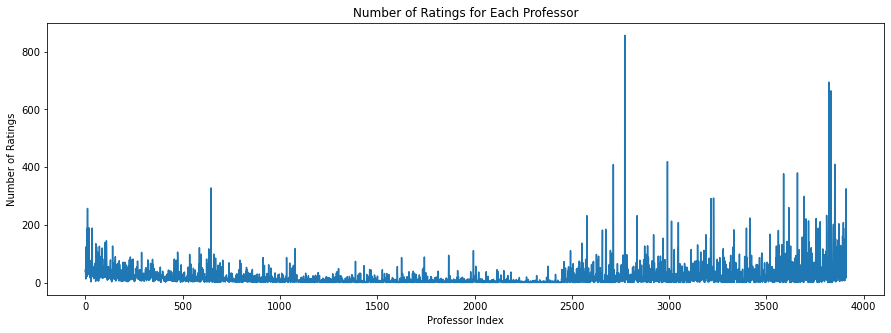

In [76]:
# Quick plot of ratings
plt.figure(figsize=(15,5))
profs['numRatings'].plot()
plt.title('Number of Ratings for Each Professor')
plt.xlabel('Professor Index')
plt.ylabel('Number of Ratings')

### Who has the most ratings?

In [77]:
# Prof with most ratings
profs.loc[profs['numRatings'].idxmax()]

firstName                     Andreas
lastName                   Toupadakis
department                  Chemistry
id               VGVhY2hlci01NjE1OTk=
legacyId                       561599
numRatings                        856
avgRating                         3.3
avgDifficulty                     3.1
Name: 2772, dtype: object

### Histograms of Quality Rating and Difficulty Rating

Text(0.5, 1.0, 'Histogram of Average Professor Quality Rating')

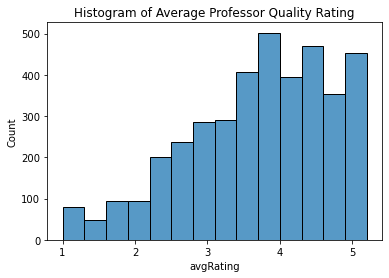

In [78]:
# Histogram of average rating
sns.histplot(profs['avgRating'], binwidth=0.3)
plt.title("Histogram of Average Professor Quality Rating")

Text(0.5, 1.0, 'Histogram of Average Professor Difficulty Rating')

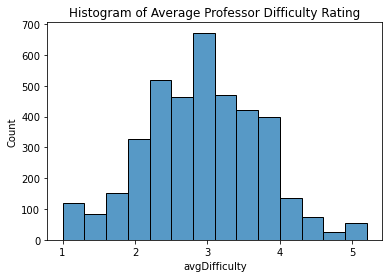

In [79]:
# Histogram of average difficulty rating
sns.histplot(profs['avgDifficulty'], binwidth=0.3)
plt.title("Histogram of Average Professor Difficulty Rating")

### Relationship between Average Difficulty Rating and Average Quality Rating

Text(0.5, 0, 'Mean Difficulty')

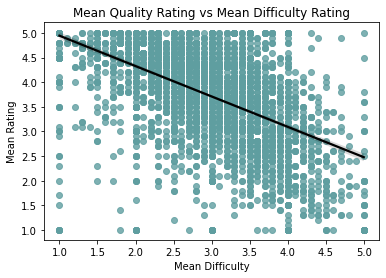

In [80]:
# Scatterplot rating vs difficulty
sns.regplot(x=profs['avgDifficulty'], y=profs['avgRating'],
            scatter_kws={"color": "cadetblue"},
            line_kws={"color": "black"})
plt.title("Mean Quality Rating vs Mean Difficulty Rating")
plt.ylabel("Mean Rating")
plt.xlabel("Mean Difficulty")

In [81]:
# Correlation
corr = profs['avgRating'].corr(profs['avgDifficulty'])
print("Correlation between average rating and average dificulty is: ", corr)

Correlation between average rating and average dificulty is:  -0.5142576356569059


### Quality Rankings, Difficulty Rankings, and Number of Reviews by Department

This time, after we group by department, we will remove any departments with a total number of ratings less than 50. These are shown below.

In [82]:
# Create and show list of departments with less than 30 total reviews 
# Group by depts aggregate sum of numRatings
num_by_dept = profs.groupby('department', as_index = False).agg({'numRatings': 'sum'})

# Sort by number of ratings
num_by_dept = num_by_dept.sort_values(by='numRatings', ascending = False)

# Remove departments with few ratings
num_by_dept = num_by_dept[num_by_dept['numRatings'] >= 50]

# Reset index
num_by_dept = num_by_dept.reset_index(drop=True)

# Create list of departments to be included
deptList = num_by_dept['department']

# Show list
deptList

0                        Mathematics
1                          Chemistry
2                            English
3                         Psychology
4                          Economics
                   ...              
84                        Biomedical
85                        Counseling
86    Environmental Science & Policy
87             International Studies
88    Atmospheric & Oceanic Sciences
Name: department, Length: 89, dtype: object

#### Quality

In [83]:
# Group by department, aggregate avgRating by mean, numRatings by sum
rating_by_dept = profs.groupby('department', as_index = False).agg({'avgRating': 'mean', 'numRatings': 'sum'})

# Filter out depts with low number reviews
rating_by_dept = rating_by_dept[rating_by_dept['department'].isin(deptList)]

# Round ratings
rating_by_dept['avgRating'] = rating_by_dept['avgRating'].round(decimals=2)

# Sort by rating (descending)
rating_by_dept = rating_by_dept.sort_values(by='avgRating', ascending=False)

# Reset index
rating_by_dept = rating_by_dept.reset_index(drop=True)

# View head, tail of dataframe
rating_by_dept

,department,avgRating,numRatings
0,Asian American Studies,4.56,69
1,Physical Education,4.53,261
2,Atmospheric & Oceanic Sciences,4.50,51
3,Latin,4.45,124
4,Spanish & Portuguese,4.36,425
...,...,...,...
84,Technoculture Studies,3.29,112
85,International Studies,3.25,53
86,Computer Science,3.19,3247
87,Agricultural & Resource Economics,3.12,371


Text(0.5, 0, 'Mean Quality Rating')

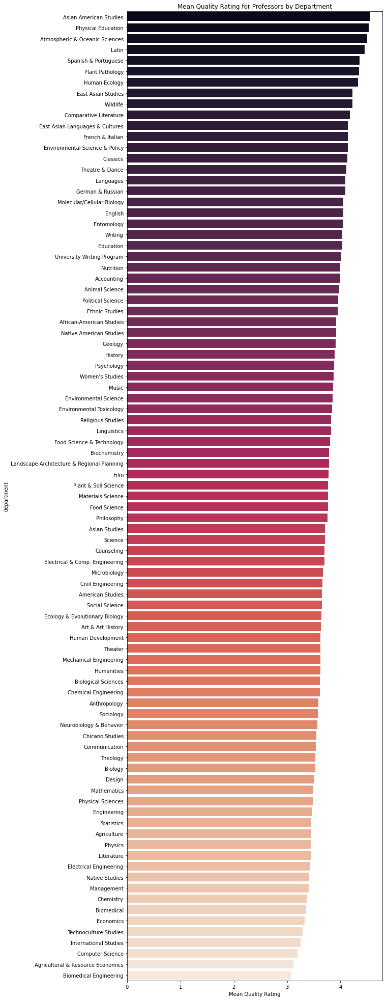

In [85]:
# Rating by dept barplot
plt.figure(figsize=(9,35))
sns.barplot( x=rating_by_dept['avgRating'], y=rating_by_dept['department'],
            palette="rocket")
plt.title("Mean Quality Rating for Professors by Department")
plt.xlabel("Mean Quality Rating")

In [86]:
# Count number of unique departments
rating_by_dept['department'].nunique()

89

#### Where does the statistics department lie in quality rankings?

In [87]:
# View statistics department ranking/average
statsRating = rating_by_dept.loc[rating_by_dept['department'] == 'Statistics']
statsRating = statsRating.reset_index()
print(f"The statistics department is ranked {statsRating.iloc[0]['index']} out of {len(rating_by_dept)} departments with a mean professor quality rating of {statsRating.iloc[0]['avgRating']} and a\
 total of {statsRating.iloc[0]['numRatings']} reviews given.")

The statistics department is ranked 74 out of 89 departments with a mean professor quality rating of 3.45 and a total of 2163 reviews given.


### Difficulty

In [88]:
# Group by department, aggregate avgDifficulty by mean, numRatings by sum
diff_by_dept = profs.groupby('department', as_index = False).agg({'avgDifficulty': 'mean', 'numRatings': 'sum'})

# Filter out depts with low number reviews
diff_by_dept = diff_by_dept[diff_by_dept['department'].isin(deptList)]

# Round difficulty ratings
diff_by_dept['avgDifficulty'] = diff_by_dept['avgDifficulty'].round(decimals=2)

# Sort by difficulty rating (descending)
diff_by_dept = diff_by_dept.sort_values(by='avgDifficulty', ascending=False)

# Reset index
diff_by_dept = diff_by_dept.reset_index(drop=True)

# View head, tail of dataframe
diff_by_dept

,department,avgDifficulty,numRatings
0,Agricultural & Resource Economics,3.84,371
1,Counseling,3.60,55
2,Chemical Engineering,3.54,178
3,Computer Science,3.47,3247
4,Ecology & Evolutionary Biology,3.45,410
...,...,...,...
84,Classics,2.31,613
85,Education,2.28,370
86,Literature,2.28,196
87,Latin,2.25,124


Text(0.5, 0, 'Mean Difficulty Rating')

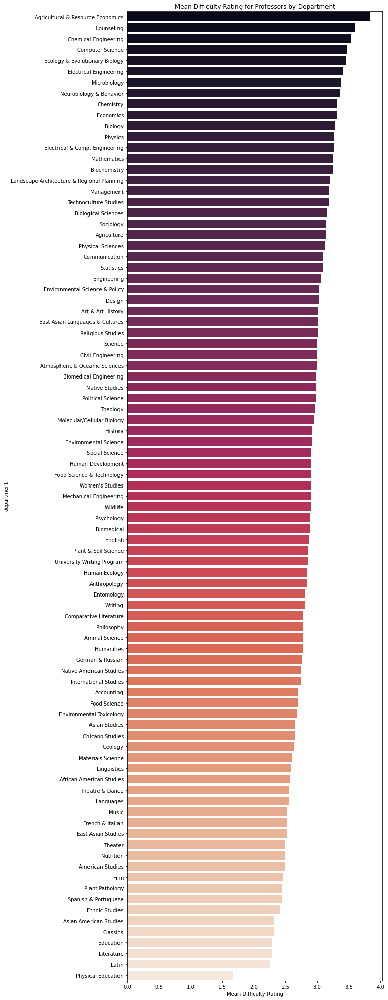

In [89]:
# Difficulty by dept barplot
plt.figure(figsize=(9,35))
sns.barplot( x=diff_by_dept['avgDifficulty'], y=diff_by_dept['department'],
            palette="rocket")
plt.title("Mean Difficulty Rating for Professors by Department")
plt.xlabel("Mean Difficulty Rating")

#### Where does the statistics department lie in difficulty rankings?

In [90]:
# View statistics department ranking/average
statsDiff = diff_by_dept.loc[diff_by_dept['department'] == 'Statistics']
statsDiff = statsDiff.reset_index()
print(f"The statistics department is ranked {statsDiff.iloc[0]['index']} out of {len(diff_by_dept)} departments with a mean professor difficulty rating of {statsDiff.iloc[0]['avgDifficulty']} and a\
 total of {statsDiff.iloc[0]['numRatings']} reviews given.")

The statistics department is ranked 23 out of 89 departments with a mean professor difficulty rating of 3.1 and a total of 2163 reviews given.


#### Number of Ratings

In [91]:
# numRatings dataframe
num_by_dept = diff_by_dept[['department', 'numRatings']].sort_values(by='numRatings', ascending=False)
num_by_dept

,department,numRatings
13,Mathematics,9293
8,Chemistry,7715
48,English,4367
46,Psychology,4288
9,Economics,4052
...,...,...
47,Biomedical,57
1,Counseling,55
25,Environmental Science & Policy,54
61,International Studies,53


Before filtering out depts with low number of ratings.

Text(0.5, 0, 'Number of Ratings')

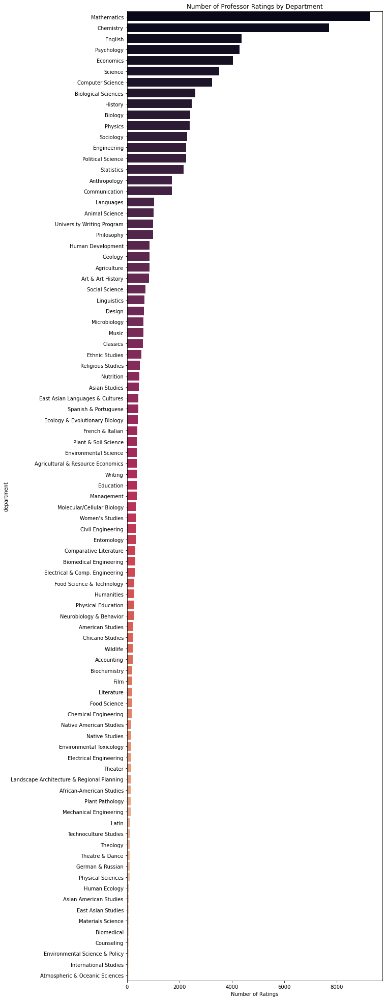

In [93]:
# Number of ratings by dept barplot
plt.figure(figsize=(9,35))
sns.barplot(x=num_by_dept['numRatings'], y=num_by_dept['department'],
            palette="rocket")
plt.title("Number of Professor Ratings by Department")
plt.xlabel("Number of Ratings")

# Small plots to include in final report

## Quality: Top and Bottom 10

(1.0, 5.0)

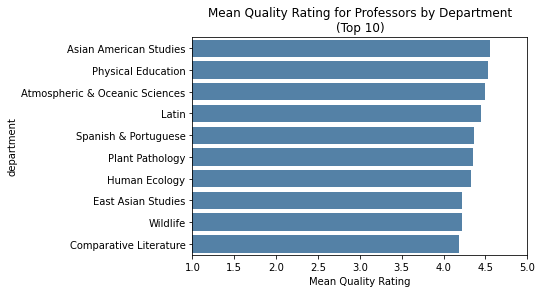

In [95]:
# Rating by dept barplot (top 10)
fig,ax = plt.subplots()
sns.barplot( x=rating_by_dept.loc[0:9, 'avgRating'], y=rating_by_dept.loc[0:9, 'department'],
            color='steelblue',
            ax = ax)
plt.title("Mean Quality Rating for Professors by Department\n(Top 10)")
plt.xlabel("Mean Quality Rating")
ax.set_xlim(1,5)

(1.0, 5.0)

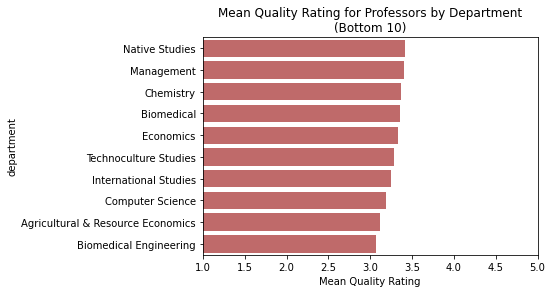

In [96]:
# Rating by dept barplot (Bottom 10)
fig,ax = plt.subplots()
sns.barplot(x=rating_by_dept.tail(10)['avgRating'], y=rating_by_dept.tail(10)['department'],
            color='indianred',
            ax = ax)
plt.title("Mean Quality Rating for Professors by Department\n(Bottom 10)")
plt.xlabel("Mean Quality Rating")
ax.set_xlim(1,5)

## Difficulty: Top and Bottom 10


(1.0, 5.0)

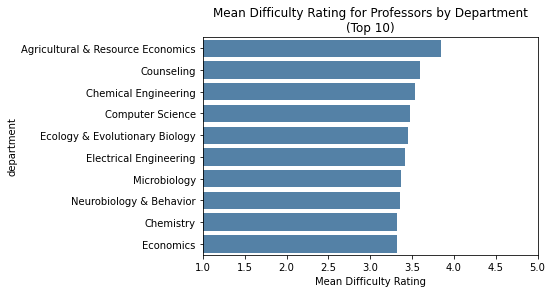

In [97]:
# Difficulty by dept barplot (top 10)
fig, ax = plt.subplots()
sns.barplot( x=diff_by_dept.head(10)['avgDifficulty'], y=diff_by_dept.head(10)['department'],
            color='steelblue',
            ax=ax)
plt.title("Mean Difficulty Rating for Professors by Department\n(Top 10)")
plt.xlabel("Mean Difficulty Rating")
ax.set_xlim(1,5)

(1.0, 5.0)

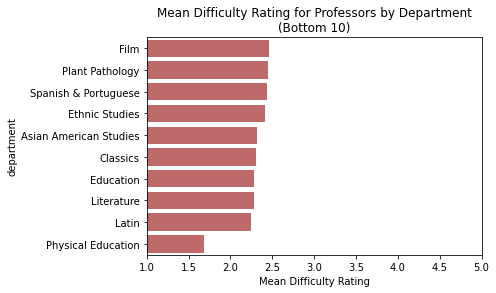

In [98]:
# Difficulty by dept barplot (bottom 10)
fig, ax = plt.subplots()
sns.barplot( x=diff_by_dept.tail(10)['avgDifficulty'], y=diff_by_dept.tail(10)['department'],
            color='indianred',
            ax=ax)
plt.title("Mean Difficulty Rating for Professors by Department\n(Bottom 10)")
plt.xlabel("Mean Difficulty Rating")
ax.set_xlim(1,5)

## Number of Ratings: Top and Bottom 10

(0.0, 10000.0)

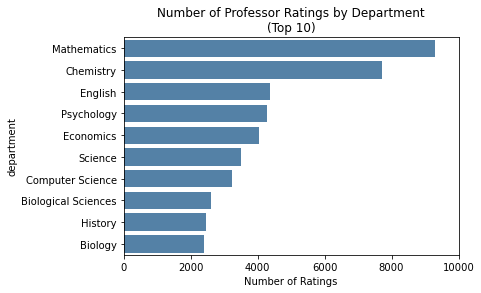

In [99]:
# Number of ratings by dept barplot
fig, ax = plt.subplots()
sns.barplot(x=num_by_dept.head(10)['numRatings'], y=num_by_dept.head(10)['department'],
            color='steelblue',
            ax=ax)
plt.title("Number of Professor Ratings by Department\n(Top 10)")
plt.xlabel("Number of Ratings")
ax.set_xlim(0,10000)

Text(0.5, 0, 'Number of Ratings')

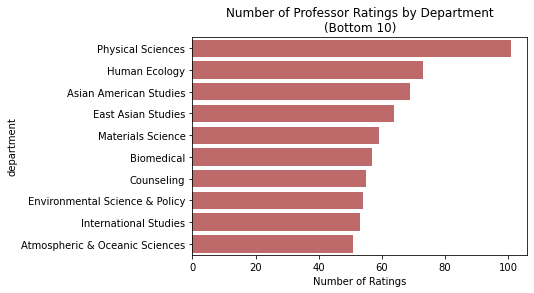

In [100]:
# Number of ratings by dept barplot
sns.barplot(x=num_by_dept.tail(10)['numRatings'], y=num_by_dept.tail(10)['department'],
    color='indianred')
plt.title("Number of Professor Ratings by Department\n(Bottom 10)")
plt.xlabel("Number of Ratings")

# Text Cleaning: comments in *reviews* dataframe

In [101]:
# Read in csv containing scraped reviews.
raw_reviews = pd.read_csv("reviews.csv", low_memory=False)
raw_reviews = raw_reviews.loc[:, raw_reviews.columns!='Unnamed: 0']
raw_reviews = raw_reviews.loc[:, raw_reviews.columns!='__typename']
raw_reviews.head()

,adminReviewedAt,attendanceMandatory,clarityRating,class,comment,createdByUser,date,difficultyRating,flagStatus,grade,...,isForCredit,isForOnlineClass,legacyId,ratingTags,teacherNote,textbookUse,thumbs,thumbsDownTotal,thumbsUpTotal,wouldTakeAgain
0,2011-01-26 17:30:48 +0000 UTC,NaN,5,HIS194,He is amazing! I had lots of fun in his class....,False,2011-01-26 17:21:05 +0000 UTC,1,UNFLAGGED,NaN,...,False,False,18184368,NaN,NaN,5.0,[],0,0,NaN
1,2010-04-06 11:26:35 +0000 UTC,NaN,2,HIS194A,"Bad prof, simply put. Thankfully, Borgen is ap...",False,2010-01-11 21:59:48 +0000 UTC,2,UNFLAGGED,NaN,...,False,False,16712359,NaN,NaN,5.0,[],0,0,NaN
2,2010-04-01 21:59:55 +0000 UTC,NaN,2,HIS194A,"Pretentious, disorganized, rants, and goes off...",False,2009-12-22 00:52:25 +0000 UTC,2,UNFLAGGED,NaN,...,False,False,16620461,NaN,NaN,5.0,[],1,0,NaN
3,2010-04-01 00:55:36 +0000 UTC,NaN,2,HIS194A,"Very disorganized in lecture, does not go into...",False,2009-12-20 04:13:29 +0000 UTC,3,UNFLAGGED,NaN,...,False,False,16608094,NaN,NaN,3.0,[],0,0,NaN
4,2010-03-09 21:34:28 +0000 UTC,NaN,3,JPN101,"Pretentious, scatter-brained, and enjoys belit...",False,2009-11-12 23:29:20 +0000 UTC,2,UNFLAGGED,NaN,...,False,False,16361756,NaN,NaN,4.0,[],0,0,NaN


In [102]:
raw_reviews.dtypes

adminReviewedAt         object
attendanceMandatory     object
clarityRating            int64
class                   object
comment                 object
createdByUser             bool
date                    object
difficultyRating         int64
flagStatus              object
grade                   object
helpfulRating            int64
id                      object
isForCredit               bool
isForOnlineClass          bool
legacyId                 int64
ratingTags              object
teacherNote             object
textbookUse            float64
thumbs                  object
thumbsDownTotal          int64
thumbsUpTotal            int64
wouldTakeAgain         float64
dtype: object

In [103]:
# Subset to relevant information from the raw data.
reviews = raw_reviews[['clarityRating', 'helpfulRating', 'difficultyRating', 'comment']]
reviews

,clarityRating,helpfulRating,difficultyRating,comment
0,5,5,1,He is amazing! I had lots of fun in his class....
1,2,1,2,"Bad prof, simply put. Thankfully, Borgen is ap..."
2,2,1,2,"Pretentious, disorganized, rants, and goes off..."
3,2,2,3,"Very disorganized in lecture, does not go into..."
4,3,2,2,"Pretentious, scatter-brained, and enjoys belit..."
...,...,...,...,...
65888,2,2,4,Probably one of the worst classes I've taken h...
65889,2,2,4,Reading memos are time consuming and there is ...
65890,4,4,4,This class was great and the professor is real...
65891,4,4,4,Professor Clerge gave us good readings and add...


In [104]:
# Remove any rows containing NAs.
reviews = reviews.dropna()
reviews

,clarityRating,helpfulRating,difficultyRating,comment
0,5,5,1,He is amazing! I had lots of fun in his class....
1,2,1,2,"Bad prof, simply put. Thankfully, Borgen is ap..."
2,2,1,2,"Pretentious, disorganized, rants, and goes off..."
3,2,2,3,"Very disorganized in lecture, does not go into..."
4,3,2,2,"Pretentious, scatter-brained, and enjoys belit..."
...,...,...,...,...
65888,2,2,4,Probably one of the worst classes I've taken h...
65889,2,2,4,Reading memos are time consuming and there is ...
65890,4,4,4,This class was great and the professor is real...
65891,4,4,4,Professor Clerge gave us good readings and add...


In [105]:
# There are nearly 928 remaining reviews with "No Comments" written.  These need to be removed as well.
reviews = reviews[reviews.comment != "No Comments"]

Although RateMyProfessors gives one score for each review, the score is actually composed of an average of two internal values for clarity and helpfulness. So we will create a new column of `qualityRating` that reflects the quality score actually presented on the website with each review.

In [106]:
# Recreate and append quality rating column.
reviews.insert(3, 'qualityRating', (reviews.clarityRating+reviews.helpfulRating)/2)
reviews

,clarityRating,helpfulRating,difficultyRating,qualityRating,comment
0,5,5,1,5.0,He is amazing! I had lots of fun in his class....
1,2,1,2,1.5,"Bad prof, simply put. Thankfully, Borgen is ap..."
2,2,1,2,1.5,"Pretentious, disorganized, rants, and goes off..."
3,2,2,3,2.0,"Very disorganized in lecture, does not go into..."
4,3,2,2,2.5,"Pretentious, scatter-brained, and enjoys belit..."
...,...,...,...,...,...
65888,2,2,4,2.0,Probably one of the worst classes I've taken h...
65889,2,2,4,2.0,Reading memos are time consuming and there is ...
65890,4,4,4,4.0,This class was great and the professor is real...
65891,4,4,4,4.0,Professor Clerge gave us good readings and add...


In [107]:
# Convert review comments to strings.
reviews = reviews.astype({'comment':'string'})
reviews

,clarityRating,helpfulRating,difficultyRating,qualityRating,comment
0,5,5,1,5.0,He is amazing! I had lots of fun in his class....
1,2,1,2,1.5,"Bad prof, simply put. Thankfully, Borgen is ap..."
2,2,1,2,1.5,"Pretentious, disorganized, rants, and goes off..."
3,2,2,3,2.0,"Very disorganized in lecture, does not go into..."
4,3,2,2,2.5,"Pretentious, scatter-brained, and enjoys belit..."
...,...,...,...,...,...
65888,2,2,4,2.0,Probably one of the worst classes I've taken h...
65889,2,2,4,2.0,Reading memos are time consuming and there is ...
65890,4,4,4,4.0,This class was great and the professor is real...
65891,4,4,4,4.0,Professor Clerge gave us good readings and add...


In [108]:
# Convert / used in the cases of descriptions into spaces for tokenization.
reviews['comment'] = [comment.replace('/', ' ') for comment in reviews.comment]
# Convert - used in the cases of descriptions into spaces for tokenization.
reviews['comment'] = [comment.replace('-', ' ') for comment in reviews.comment]

In [109]:
# Tokenize comments into words.
comment_words = [nltk.word_tokenize(comment) for comment in reviews.comment]

In [110]:
# Convert tokens to lowercase.
comment_words = [[word.lower() for word in word_list] for word_list in comment_words]

We next need to lemmatize the words.

In [111]:
# Creates a list of lists of tuples with word and part of speech for each coment 
comment_words_pos = [nltk.pos_tag(word_list) for word_list in comment_words]

In [112]:
# Function to convert Treebank part of speech tags into WordNet tags.
def wordnet_pos(treebank_pos):
    '''Converts Treebank pos tags into WordNet tags.
    '''
    if treebank_pos.startswith('J'):
        return nltk.corpus.wordnet.ADJ
    elif treebank_pos.startswith('V'):
        return nltk.corpus.wordnet.VERB
    elif treebank_pos.startswith('N'):
        return nltk.corpus.wordnet.NOUN
    elif treebank_pos.startswith('R'):
        return nltk.corpus.wordnet.ADV
    else:
        return None

In [113]:
# Convert Treebank part of speech tags into WordNet tags.
comment_words_pos = [[(word, wordnet_pos(pos)) for word, pos in comment] for comment in comment_words_pos]

In [114]:
# Fuction to lemmatize a word with ntlk.WordNetLemmatizer.
def wordnet_lemmatize(word, pos):
    '''This function takes in a word and a part of speech (word, pos) tuple and uses an
    ntlk.WordNetLemmatizer object to lemmatize the word.  Part of speech must be given
    as a WordNet tag, or as None.
    '''
    # Create lemmatizer.
    lemmatizer = nltk.WordNetLemmatizer()
    # If part of speech provided, lemmatize using it, otherwise do not.
    if pos is not None:
        lemma_word = lemmatizer.lemmatize(word, pos)
    else:
        lemma_word = lemmatizer.lemmatize(word)
    return lemma_word

In [115]:
# Lemmatize.
comment_words = [[wordnet_lemmatize(word, pos) for word, pos in comment] for comment in comment_words_pos]

Now we will remove punctuation and stopwords.

In [116]:
# Create a list of punctuation to remove
punct = ['.', ',', ';', ':', '-', '--', '(', ')', '[', ']', '...', '&', '!', '@', '$']
# Remove punctuation.
comment_words = [[word for word in comment if word not in punct] for comment in comment_words]

In [117]:
# Get a list of stopwords English from nltk corpus.
stopwords = nltk.corpus.stopwords.words('english')
# This list of stopwords contains 'not'.  However 'not' is important for sentiment negation.
stopwords.remove('not')
# Remove stopwords from list of words.
comment_words = [[word for word in comment if word not in stopwords] for comment in comment_words]

There is some remaining non-English text that must be removed. This is a computational problem because the NLTK corpus of English words that we intend to use contains 236736 words. (This dataset does not contain conjugations which is why we needed to lemmatize first) Directly checking if each word in our dataset is within that corpus or not would take a very long time. A much faster approach is to first create a set of all the unique words and then only compare the each unique word. From there, we can work backwards to elmininate all of the non-English words from the original list of words.

**STOP!** The code below takes approximately 20 minutes to run completely. We recommend jumping to the Data Analysis Models section.

In [ ]:
# Create a list of all words in English (from NLTK).
eng_words = nltk.corpus.words.words()

In [ ]:
# Create a list of all unique words in comment_words.
words_list = [word for comment in comment_words for word in comment]
unique_words = list(set(words_list))

In [ ]:
# Create a list of non-English words in our list of words.
non_eng_words = [word for word in unique_words if word not in eng_words]

In [ ]:
# Remove non-English words from list of words.
comment_words = [[word for word in comment if word not in non_eng_words] for comment in comment_words]

Convert list of lists of words into a list of strings of words separated by spaces. We must do this because CSVs don't store datatypes.

In [ ]:
comment_words = [" ".join(words) for words in comment_words]

In [ ]:
comment_words

['amazing lot fun class get use may seem little bit odd',
 'bad prof simply put thankfully apparently retire either year next either way generation history student spar horrible teaching ability epitome ineffective archaic prof would rather spend day research teach not hard not expect learn',
 'pretentious disorganize rant go tangent reading beyond demand smart choose read not attempt reading impossible unnecessary exam hard insofar choose not mindless useless reading would suffer not recommend ever',
 'disorganize lecture not go detail explain term idea name event expect read lot material never go class reading class lot almost impossible identify specific passage test overall quot quot teacher not recommend',
 'pretentious scatter brain enjoy student stupid question lead critical analysis not hard reading though avoid sleeping lecture particular affliction',
 'little time man know talk push student get mean material lot reading test pack reading go test fine fair grader wish teach no

Concatenate this final list back onto the dataframe.

In [10]:
# Append the new column of word lists onto the dataframe.
reviews = reviews.assign(commentWords=comment_words)
reviews.head()

NameError: name 'comment_words' is not defined

In [ ]:
# Remove any rows where all words have been removed in the process above.
reviews = reviews[reviews['commentWords'] != '']

In [ ]:
reviews.to_csv('reviews_cleaned.csv')

# Data Analysis Models

In [119]:
# Read in csv containing cleaned reviews.
reviews = pd.read_csv("reviews_cleaned.csv")
reviews = reviews.loc[:, reviews.columns!='Unnamed: 0']
reviews

,clarityRating,helpfulRating,difficultyRating,qualityRating,comment,commentWords
0,5,5,1,5.0,He is amazing! I had lots of fun in his class....,amazing lot fun class get use may seem little ...
1,2,1,2,1.5,"Bad prof, simply put. Thankfully, Borgen is ap...",bad prof simply put thankfully apparently reti...
2,2,1,2,1.5,"Pretentious, disorganized, rants, and goes off...",pretentious disorganize rant go tangent readin...
3,2,2,3,2.0,"Very disorganized in lecture, does not go into...",disorganize lecture not go detail explain term...
4,3,2,2,2.5,"Pretentious, scatter brained, and enjoys belit...",pretentious scatter brain enjoy student stupid...
...,...,...,...,...,...,...
64767,2,2,4,2.0,Probably one of the worst classes I've taken h...,probably one bad class take feel support guide...
64768,2,2,4,2.0,Reading memos are time consuming and there is ...,reading memo time consume one due every class ...
64769,4,4,4,4.0,This class was great and the professor is real...,class great professor really knowledgeable thi...
64770,4,4,4,4.0,Professor Clerge gave us good readings and add...,professor give u good reading additional optio...


In [120]:
# Convert review comments to strings.
reviews = reviews.astype({'commentWords':'string'})
reviews.head()

,clarityRating,helpfulRating,difficultyRating,qualityRating,comment,commentWords
0,5,5,1,5.0,He is amazing! I had lots of fun in his class....,amazing lot fun class get use may seem little ...
1,2,1,2,1.5,"Bad prof, simply put. Thankfully, Borgen is ap...",bad prof simply put thankfully apparently reti...
2,2,1,2,1.5,"Pretentious, disorganized, rants, and goes off...",pretentious disorganize rant go tangent readin...
3,2,2,3,2.0,"Very disorganized in lecture, does not go into...",disorganize lecture not go detail explain term...
4,3,2,2,2.5,"Pretentious, scatter brained, and enjoys belit...",pretentious scatter brain enjoy student stupid...


In [121]:
# Remove any rows with NAs that remain.
reviews = reviews.dropna()

## Logistic Regression

We need to create a new column for sentiment for our logistic regression model. We will consider quality scores above 3 to be positive and those below 3 to be negative. Rows with scores of 3 exactly will be removed.

In [122]:
# Remove rows from the dataframe where score is 3
reviews = reviews[reviews['qualityRating'] != 3.0]

In [123]:
# Add a new column for 'sentiment'
sentiment = reviews['qualityRating'].apply(lambda x: 1 if x > 3 else -1)
reviews = reviews.assign(sentiment=sentiment)

Here we need to split the data into a training set and a test set. Typically, this is done with a 80/20 ratio.

In [124]:
# Split the data into a 80% train set and a 20% test set
rv_train, rv_test = train_test_split(reviews, test_size=0.2)

Now we need to create a bag of words model out of our comments.

In [125]:
# Create count vectorizer object to generate sparse matrix.
count_vectorizer = CountVectorizer(tokenizer=nltk.word_tokenize)

In [126]:
# Create bag of words matrix for training data.
rv_train_matrix = count_vectorizer.fit_transform(rv_train['commentWords'])

In [127]:
# Fit the test data to bag of words matrix.
rv_test_matrix = count_vectorizer.transform(rv_test['commentWords'])

Conduct a basic logistic regression.

In [128]:
# Initialize logistic regression object.
lr = LogisticRegression(max_iter = 1000000)

In [129]:
# Fit the logistic regression model.
lr.fit(rv_train_matrix, rv_train['sentiment'])

LogisticRegression(max_iter=1000000)

In [130]:
# Generate predicted values for test data.
pred = lr.predict(rv_test_matrix)

In [131]:
# Output confusion matrix.
confusion_matrix(pred, rv_test['sentiment'])

array([[2644,  553],
       [ 833, 7750]], dtype=int64)

In [132]:
# Output the classification report of the logistic regression.
print(classification_report(pred, rv_test['sentiment']))

              precision    recall  f1-score   support

          -1       0.76      0.83      0.79      3197
           1       0.93      0.90      0.92      8583

    accuracy                           0.88     11780
   macro avg       0.85      0.86      0.86     11780
weighted avg       0.89      0.88      0.88     11780



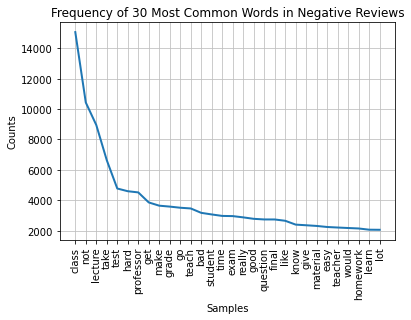

<AxesSubplot:title={'center':'Frequency of 30 Most Common Words in Negative Reviews'}, xlabel='Samples', ylabel='Counts'>

In [133]:
# Create a plot of the frequency of the 30 most common words in negative reviews.
reviews_neg = reviews[sentiment == -1]
words = " ".join(reviews_neg.commentWords)
words = words.split()
freq = nltk.FreqDist(words)
freq.plot(30, title="Frequency of 30 Most Common Words in Negative Reviews")

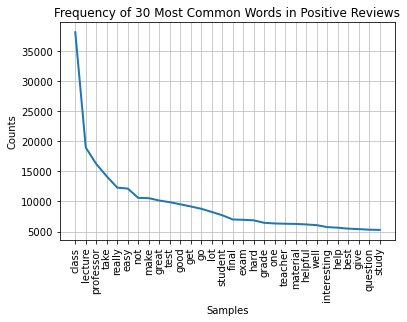

<AxesSubplot:title={'center':'Frequency of 30 Most Common Words in Positive Reviews'}, xlabel='Samples', ylabel='Counts'>

In [134]:
# Create a plot of the frequency of the 30 most common words in positive reviews.
reviews_pos = reviews[sentiment == 1]
words = " ".join(reviews_pos.commentWords)
words = words.split()
freq = nltk.FreqDist(words)
freq.plot(30, title="Frequency of 30 Most Common Words in Positive Reviews")

### Concatenating "Not" 

Consider for a moment sentences like the following: "This professsor is not good." Our data processing would have reduced this to a string containing `professor not good`. Intuitively, we are aware that the "not" preceding "good" negates the meaning of good. This is a likely explaination for why "good" and other positive words appear so frequently in negative reviews. One possible solution to this issue is to simply combine not into the word that follows it.

In [135]:
def concat_not(comment_string):
    '''Takes a string input and concatenates any instance of the word "not" to the word that follows.
    If "not" is the final word, it is unaffected.  Returns a new string of the updated words.
    '''
    # Splits string into list of words
    word_list = comment_string.split()
    # Iterates through the list of words and concatenates not onto the word following not.
    # If not is the final word it is left unchanged.
    for index, word in enumerate(word_list):
        if word == 'not' and index != len(word_list)-1:
            word_list[index+1] = 'not' + word_list[index+1]
            word_list[index] = None
    # Join list of words back into a string while filtering out none values.
    comment_string = ' '.join(filter(None, word_list))
    return comment_string

In [136]:
def series_concat_not(series):
    '''Applies concat_not function to all elements of a series of strings
    '''
    new_series = series.copy()
    for index, string in new_series.items():
        new_series.loc[index] = concat_not(string)
    return new_series

In [137]:
# Apply the series_concat_not function to the training and test data.
cv_train_words = series_concat_not(rv_train['commentWords'])
cv_test_words = series_concat_not(rv_test['commentWords'])

In [138]:
# Create new count matrices and fit a new logistic regression model.
cv_train_matrix = count_vectorizer.fit_transform(cv_train_words)
cv_test_matrix = count_vectorizer.transform(cv_test_words)

lr.fit(cv_train_matrix, rv_train['sentiment'])
cv_pred = lr.predict(cv_test_matrix)

In [139]:
confusion_matrix(cv_pred, rv_test['sentiment'])

array([[2714,  503],
       [ 763, 7800]], dtype=int64)

In [140]:
print(classification_report(cv_pred, rv_test['sentiment']))

              precision    recall  f1-score   support

          -1       0.78      0.84      0.81      3217
           1       0.94      0.91      0.92      8563

    accuracy                           0.89     11780
   macro avg       0.86      0.88      0.87     11780
weighted avg       0.90      0.89      0.89     11780



Concatenating "not" only provides a slight improvement to the logistic regression.

### Logisitic Regression with Bigrams

In [141]:
# Implement the above process of logistic regression with bigrams instead.
bg_count_vectorizer = CountVectorizer(tokenizer=nltk.word_tokenize, ngram_range=(2,2))
bg_rv_train_matrix = bg_count_vectorizer.fit_transform(rv_train['commentWords'])
bg_rv_test_matrix = bg_count_vectorizer.transform(rv_test['commentWords'])

lr.fit(bg_rv_train_matrix, rv_train['sentiment'])
bg_pred = lr.predict(bg_rv_test_matrix)

print(classification_report(bg_pred, rv_test['sentiment']))

              precision    recall  f1-score   support

          -1       0.71      0.85      0.78      2902
           1       0.95      0.89      0.92      8878

    accuracy                           0.88     11780
   macro avg       0.83      0.87      0.85     11780
weighted avg       0.89      0.88      0.88     11780



In [142]:
confusion_matrix(bg_pred, rv_test['sentiment'])

array([[2481,  421],
       [ 996, 7882]], dtype=int64)

In [143]:
print(classification_report(bg_pred, rv_test['sentiment']))

              precision    recall  f1-score   support

          -1       0.71      0.85      0.78      2902
           1       0.95      0.89      0.92      8878

    accuracy                           0.88     11780
   macro avg       0.83      0.87      0.85     11780
weighted avg       0.89      0.88      0.88     11780



The bigram model does not seem to improve the results of the logisitic regression.